In [26]:
import os, sys

sys.path.append(
    os.path.dirname(os.getcwd())
)
import json
from pprint import pprint
from glob import glob
import numpy as np
import matplotlib.pyplot as plt
import cv2

import trimesh
import plotly.graph_objects as go
import PIL
from PIL import Image

import pygarment as pyg

from analysis_utils import (
    set_constants,
    # visualize_meshes_plotly,
    euler_angles_to_rotation_matrix,
    plot_panel_info,
    v_id_map
)


DATASET_ROOT = set_constants()

GARMENT_ROOT_PATH = os.path.join(DATASET_ROOT, "GarmentCodeData_v2")
BODY_ROOT_PATH = os.path.join(DATASET_ROOT, "body_mesh")
MEAN_ALL_BODY_PATH = os.path.join(DATASET_ROOT, "neutral_body/mean_all.obj")

default_body_mesh = trimesh.load(MEAN_ALL_BODY_PATH)


# BODY_TYPE = "random_body"
BODY_TYPE = "default_body"

garment_path_list = sorted(list(filter(
    os.path.isdir,
    glob(os.path.join(GARMENT_ROOT_PATH, "*", BODY_TYPE, "*"))
)))

len(garment_path_list)

132670

In [31]:
MEAN_ALL_BODY_PATH

'/media/hjp/05aba9a7-0e74-4e54-9bc9-5f11b9c4c757/GarmentCodeData/neutral_body/mean_all.obj'

In [27]:


def visualize_meshes_plotly(
    mesh_list,
    color_list=None,
    vertices_list = None,
    vertices_color_list = None,
    vertex_marker_size = 2,
    show_edges = True,
    edge_width = 2,
):
    # Pre-convert to list and load meshes once
    mesh_list = [mesh_list] if not isinstance(mesh_list, list) else mesh_list
    final_mesh_list = [trimesh.load(m) if isinstance(m, str) else m for m in mesh_list]
    
    color_list = color_list or ['lightgray'] * len(final_mesh_list)
    
    # Create all mesh traces at once
    mesh_traces = []
    edge_traces = []
    for mesh, color in zip(final_mesh_list, color_list):
        face_colors = mesh.visual.face_colors[:, :3] if hasattr(mesh.visual, 'face_colors') else None
        mesh_traces.append(go.Mesh3d(
            x=mesh.vertices[:, 0],
            y=mesh.vertices[:, 1],
            z=mesh.vertices[:, 2],
            i=mesh.faces[:, 0],
            j=mesh.faces[:, 1],
            k=mesh.faces[:, 2],
            opacity=0.5,
            facecolor=face_colors,
            color=None if face_colors is not None else color
        ))
        
        if show_edges:
            edge_x = []
            edge_y = []
            edge_z = []
            vertices = mesh.vertices
            for edge in mesh.edges:
                edge_x.extend([vertices[edge[0], 0], vertices[edge[1], 0], None])
                edge_y.extend([vertices[edge[0], 1], vertices[edge[1], 1], None])
                edge_z.extend([vertices[edge[0], 2], vertices[edge[1], 2], None])
        
            edge_traces.append(go.Scatter3d(
                x=edge_x, y=edge_y, z=edge_z,
                mode='lines',
                line=dict(
                    color = color if color is not None else 'red',
                    width=edge_width
                ),
                name='Edges'
            ))
    
    fig = go.Figure(data = mesh_traces + edge_traces)
    
    if vertices_list is not None and vertices_color_list is not None:
        for vertex, color in zip(vertices_list, vertices_color_list):
            fig.add_trace(go.Scatter3d(
                x=vertex[:, 0],
                y=vertex[:, 1],
                z=vertex[:, 2],
                mode='markers',
                marker=dict(size=vertex_marker_size, color=color, opacity=1),
                name='Vertices'
            ))
            fig.add_trace(go.Scatter3d(
                x=vertex[:, 0],
                y=vertex[:, 1],
                z=vertex[:, 2],
                mode='lines',
                line=dict(color=color, width=2),
                name='Polyline'
            ))
    fig.update_layout(
        scene=dict(aspectmode='data'),
        width=800,
        height=800,
        showlegend=False
    )
    
    fig.show()


In [10]:
default_body_mesh.vertices.max()

np.float64(1.7199014649)

In [35]:
import json
#TODO: 내가 쓴 코드.
json_file_path = "/media/hjp/db6095ca-a560-4c3a-90ad-b667ec189671/REFERENCES/3D_VTO/GarmentCode/GarmentCode/ANALYSIS_josef/garment_without_arc_list.json"

def load_json_file(file_path):
    with open(file_path, 'r') as file:
        data = json.load(file)
    return data

json_data = load_json_file(json_file_path)
garment_path = json_data[11296]

garment_id= os.path.basename(garment_path)
spec_path = os.path.join(garment_path,  f"{garment_id}_specification.json")


In [34]:
trimesh.load(MEAN_ALL_BODY_PATH)

<trimesh.Trimesh(vertices.shape=(23751, 3), faces.shape=(47500, 3), name=`mean_all.obj`)>

In [36]:
import random
"""
IDX = 0
IDX = random.randint(0, len(garment_path_list) - 1)

garment_path = garment_path_list[IDX]


garment_id = os.path.basename(garment_path)
SPEC_FILE_PATH = os.path.join(garment_path, f"{garment_id}_specification.json")
"""
default_body_mesh = trimesh.load(MEAN_ALL_BODY_PATH)
default_body_mesh.apply_scale(100)

with open(SPEC_FILE_PATH, "r") as f:
    spec = json.load(f)
    
pattern = pyg.pattern.wrappers.VisPattern(SPEC_FILE_PATH)

# Get Garment Blueprint
panel_svg_path_dict = {
    panel_name : pattern._draw_a_panel(
        panel_name, apply_transform=False, fill=True
    )
    for panel_name in pattern.panel_order()
}
stitch_dict = {
    i : v for i, v in enumerate(pattern.pattern['stitches'])
}

box_mesh = trimesh.load_mesh(
    os.path.join(garment_path, f"{garment_id}_boxmesh.ply"),
    process=False
)

idx_convert_map = v_id_map(box_mesh.vertices)
idx_convert_map_arr = np.array(idx_convert_map)

# Read Vertex Label
with open(os.path.join(garment_path, f"{garment_id}_sim_segmentation.txt"), "r") as f:
    segmentation = list(map(
        lambda x : x.strip(),
        f.readlines()
    ))

stitch_vertex_mask_dict = {}
for k in stitch_dict.keys():
    raw_mask = list(map(
        lambda x : True if f"stitch_{k}" in x.split(",") else False,
        segmentation
    ))
    base_mask = np.array(list(map(
        lambda idx : True if raw_mask[idx] else False,
        idx_convert_map
    )))
    stitch_vertex_mask_dict[k] = base_mask


lifted_panel_vertex_arr_list = []
batch_point_list = []
for panel_name, panel in panel_svg_path_dict.items():
    vertices_from_spec = np.asarray(spec['pattern']['panels'][panel_name]['vertices'])    
    offset = np.min(vertices_from_spec * np.array([1, -1]), axis=0)

    euler_angles = spec['pattern']['panels'][panel_name]['rotation']
    translation = spec['pattern']['panels'][panel_name]['translation']
    rotation_matrix = euler_angles_to_rotation_matrix(euler_angles)

    path = panel[0]
    
    x1, x2, y1, y2 = path.bbox()
    xm = (x1 + x2) / 2
    ym = (y1 + y2) / 2 

    vertices_from_svg = np.array(list(map(
        lambda edge : [edge.start.real, edge.start.imag],
        path
    )))
    vertices = np.vstack([
        vertices_from_svg,
        vertices_from_svg[0], # add start point to close the loop
    ])
    vertices = (vertices + offset) * np.array([1, -1])
    panel_vertex_arr = np.hstack([
        vertices,
        np.zeros((vertices.shape[0], 1))
    ]) @ rotation_matrix.T + translation
    
    lifted_panel_vertex_arr_list.append(panel_vertex_arr)
    
    bbox_center = np.array([xm, ym])
    bbox_center = (bbox_center + offset) * np.array([1, -1])
    
    batch_point = np.array([
        bbox_center[0], bbox_center[1], 1
    ]) @ rotation_matrix.T + translation
    
    batch_point_list.append(batch_point.reshape(1, -1))
    

visualize_meshes_plotly(
    [box_mesh,
     default_body_mesh
    ],
    show_edges=False,
    vertices_list=[
        *lifted_panel_vertex_arr_list,
        *batch_point_list,
        *list(map(
            lambda mask: box_mesh.vertices[mask],
            stitch_vertex_mask_dict.values()
        ))
    ],
    vertices_color_list=[
        *["red"] * len(batch_point_list),
        *["blue"] * len(lifted_panel_vertex_arr_list),
        *["yellow"] * len(stitch_vertex_mask_dict.values())
    ]
)
print(IDX)

45151


In [12]:
# 바디 메시만 시각화
visualize_meshes_plotly(
    [default_body_mesh],  # 바디 메시만 리스트에 포함
    show_edges=False,  # 메시의 엣지를 숨길지 여부 (원하면 True로 변경 가능)
    vertices_list=[],  # 추가적인 점들을 표시하지 않음
    vertices_color_list=[]  # 색상도 없음
)

In [12]:
panel_svg_path_dict

{'ins_skirt_back_0': (Path(Line(start=41j, end=(8.5+0j)),
       Line(start=(8.5+0j), end=(17+41j)),
       Line(start=(17+41j), end=41j)),
  {'fill': 'rgb(227,175,186)',
   'stroke': 'rgb(51,51,51)',
   'stroke-width': '0.2'},
  False),
 'ins_skirt_front_0': (Path(Line(start=41j, end=(17+41j)),
       Line(start=(17+41j), end=(8.5+0j)),
       Line(start=(8.5+0j), end=41j)),
  {'fill': 'rgb(227,175,186)',
   'stroke': 'rgb(51,51,51)',
   'stroke-width': '0.2'},
  True),
 'ins_skirt_back_1': (Path(Line(start=41j, end=(8.5+0j)),
       Line(start=(8.5+0j), end=(17+41j)),
       Line(start=(17+41j), end=41j)),
  {'fill': 'rgb(227,175,186)',
   'stroke': 'rgb(51,51,51)',
   'stroke-width': '0.2'},
  False),
 'ins_skirt_front_1': (Path(Line(start=41j, end=(17+41j)),
       Line(start=(17+41j), end=(8.5+0j)),
       Line(start=(8.5+0j), end=41j)),
  {'fill': 'rgb(227,175,186)',
   'stroke': 'rgb(51,51,51)',
   'stroke-width': '0.2'},
  True),
 'ins_skirt_back_2': (Path(Line(start=41j, end=(

In [ ]:
77086
114120

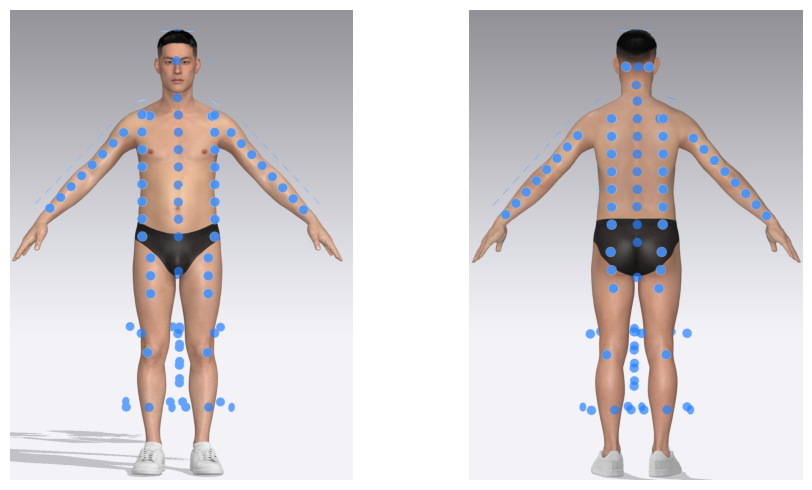

In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# 1) PNG 파일 두 개 불러오기
img_path1 = "Clo_No_arc_dir/back.png"
img_path2 = "Clo_No_arc_dir/front.png"

img1 = mpimg.imread(img_path1)
img2 = mpimg.imread(img_path2)

# 2) 서브플롯을 가로로 2개 생성
fig, axes = plt.subplots(1, 2, figsize=(10, 5))  # 가로로 2개의 서브플롯, (10, 5)는 그림 크기 지정

# 왼쪽 서브플롯에 첫 번째 이미지 표시
axes[0].imshow(img2)
axes[0].axis("off")    # 축(눈금, 테두리) 숨기기

# 오른쪽 서브플롯에 두 번째 이미지 표시
axes[1].imshow(img1)
axes[1].axis("off")

plt.tight_layout()     # 서브플롯 간격 자동 조절
plt.show()

In [1]:
print("asd")

asd


In [ ]:

SPEC_FILE_PATH = os.path.join(garment_path, f"{garment_id}_specification.json")
pattern = pyg.pattern.wrappers.VisPattern(SPEC_FILE_PATH)

# Get Garment Blueprint
panel_svg_path_dict = {
    panel_name : pattern._draw_a_panel(
        panel_name, apply_transform=False, fill=True
    )
    for panel_name in pattern.panel_order()
}
stitch_dict = {
    i : v for i, v in enumerate(pattern.pattern['stitches'])
}

FIGLEN = 4
NCOLS = int(np.sqrt(len(panel_svg_path_dict)))
NROWS = int(np.ceil(len(panel_svg_path_dict) / NCOLS))

plt.figure(figsize=(FIGLEN * NCOLS, FIGLEN * NROWS))
for i, (panel_name, panel) in enumerate(panel_svg_path_dict.items()):
    ax = plt.subplot(NROWS, NCOLS, i + 1)
    ax.set_title(panel_name)
    plot_panel_info(
        ax, panel_name, panel_svg_path_dict, stitch_dict,
        N_SAMPLES=1000
    )
# plt.savefig(f"{garment_id}_panel_vis.png")
plt.show()

FileNotFoundError: [Errno 2] No such file or directory: 'seph'

In [46]:
# 아바타 정보와 의류 정보를 불러오는 거 까지.
import os
import json

import import_api
import utility_api
import fabric_api
import pattern_api
import export_api
import ApiTypes
import time


#SAVE_ROOT_PATH = "/Users/seph/Desktop/DATASET_PROTOTYPE"
#os.makedirs(SAVE_ROOT_PATH, exist_ok=True)


ieo_option = ApiTypes.ImportExportOption()
ieo_option.bExportGarment = True
ieo_option.bExportAvatar = False
ieo_option.bSingleObject = False # single or Multiple
#ieo_option.weldType = WELD_TYPE
ieo_option.bThin = False
ieo_option.bSaveInZip = False

# 아바타 load

avtfilePath = "/Users/seph/Documents/clo/Assets/Avatar/Avatar/Male_V2/2024_0131_last.avt"
custom_point_path = "/Users/seph/Desktop/고려대_인턴_연구실/View_Point"
pose_path = "/Users/seph/Desktop/고려대_인턴_연구실/Pose"
import os

DATA_DIR = "./Clo_No_arc_dir"

for path in os.listdir(DATA_DIR):
    SUB_DIR = os.path.join(DATA_DIR, path)
    for file in os.listdir(SUB_DIR):
        if file.endswith(".json"):
            JSON_PATH = os.path.join(SUB_DIR, file)
            
            import_api.ImportFile(avtfilePath) # avatar import
            pattern_api.ImportPatternJSON(JSON_PATH) # garment import

            export_api.ExportSnapshot3D(os.path.join(SUB_DIR,f"{file}_before_drape.png"))
            export_api.ExportOBJ(os.path.join(SUB_DIR,f"{file}_before_drape.obj"),ieo_option)

            utility_api.Simulate(100)
            # 드레이핑 후 obj 뽑기
            export_api.ExportSnapshot3D(os.path.join(SUB_DIR,f"{file}_after_drape.png"))
            export_api.ExportOBJ(os.path.join(SUB_DIR,f"{file}_after_drape.obj"), ieo_option)

            utility_api.NewProject()

            for pose in os.listdir(pose_path):
                pose_file = os.path.join(pose_path, pose)
                import_api.ImportFile(custom_point) # view import
                import_api.ImportFile(avtfilePath) # avatar import
                pattern_api.ImportPatternJSON(JSON_PATH) # garment import
                import_api.ImportPose(pose_file)

                for custom_point in os.listdir(custom_point_path):
                    custom_point_file = os.path.join(custom_point_path, custom_point)
                    utility_api.Simulate(100)
                    export_api.ExportSnapshot3D(os.path.join(SUB_DIR,f"{pose}_{custom_point}_before_pose.png"))
                    export_api.ExportOBJ(os.path.join(SUB_DIR,f"{pose}_{custom_point}_after_pose.obj"),ieo_option)

            utility_api.NewProject()            
            
        



# Data Path settings
#obj_path1 = "/Users/seph/Desktop/PPT_시각자료/clo_python_store/pre_drape.obj"
#obj_path2 = "/Users/seph/Desktop/PPT_시각자료/clo_python_store/after_drape.obj"
#obj_path3 = "/Users/seph/Desktop/PPT_시각자료/clo_python_store/after_pose.obj"

#jpg_path1 ="/Users/seph/Desktop/PPT_시각자료/clo_python_store/pre_drape.jpg"
#jpg_path2 = "/Users/seph/Desktop/PPT_시각자료/clo_python_store/after_drape.jpg"
# Custom Camera view


# Garment
#json_path = "/Users/seph/Downloads/exportpattern22.json"
# motion
#motion_path = "/Users/seph/Documents/clo/Assets/Avatar/Avatar/Male_V2/Motion/MV2_08_Training.mtn"
# pose





SyntaxError: EOF while scanning triple-quoted string literal (3039413438.py, line 84)